# Battle of the Neighborhoods - opening restaurants in Greater Area London

## Introduction/Business Problem

&emsp;A prominent restaurant enterpreneur in UK that runs restaurants serving Italian, American and Mexican dishes thinks of opening more restaurants in Greater London area to increase business coverage. London is known for its vivid cuisine scene and there is abundance of the restaurants and food joints satisfying all tastes. The question is where to open and which restaurant to open? There are several parameters that can help assessing future of newly opened restaurant:
1. <b>Abundance of similair restaurants</b> in the same area. For instance, it would be unwise to open Italians restaurant in the area where there are already many Italian restaurants open, particularly if they have high rating. It will be hard to compete and may cause monetary losses. 
2. Another factor for decision is <b>population/housing density</b> - suburban districts oftentimes are dominated by the houses for 1 family and can be characterized by the low population density. Such districts are not able to support many small businesses - there will be not enough clients to achieve profit. Open areas and parks in the vicinity of the neighborhood will impact population density as well. 
3. <b>Income</b> of citizens can also determine whether restaurant will be succesfull or not. Higher income in the neighborhood would be benefitial for new restaurant.
4. <b>Population growth</b> - if population is expected to grow, restaurant will be able to serve more customers.

Enterpreneur turns to data scientist and asks to provide data-based answers for the <b>three main questions</b>:
- Which Greater London areas are the best to open restaurant(s)?
- Which cuisine(s) are the best option to open in the identified areas?
- What price range for newly opened restaurant should be considered (low or high price tag)



## Data sources and description

&emsp;Greater London Area that will be studying has 32 local government districts called <b>borough</b> plus special district of City of London. Each borough is divided by <b>wards</b> which serve as primary electoral geographical unit. We will use wards as a proxy for neighborhoods. We will exclude City of London from the analysis and concentrate on all other areas of inner and outer London.

<br>&emsp;For this project we will utilize following datasets:</br>
1. [Greater London Area (GLA) Land Area and Population Density, Ward and Borough](https://data.london.gov.uk/dataset/land-area-and-population-density-ward-and-borough). This open dataset is based on the census from 2011 with some updated data from 2016, as well as projections of population till year 2050. We will use predicted for 2021 data on total population, population density, area. It is clear that population density equals population divided by area. At this stage of the project we can not yet make decision which parameter exactly we will be using. However, we know that we want to discriminate between densely and sparsely populated areas. We will use projected population by 2026 to compute population growth which serves as good indicator to select prospective wards: if population will grow, more potential customers restaurant will have.
2. [Shapefiles of wards in 2011](https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london). We will use shape files of wards as they were in 2011 to find centroid of each ward that we will use to call Foursquare API.
3. <b>Foursquare API to fetch</b> infomation about venues in each of the wards. We will use coordinates obtained from the dataset #2. We will be extracting information about type of the venue. We will only be calling venues that serve food (cafes, fastfood joints, restaurants etc).
4. [Median income data for wards](https://data.london.gov.uk/dataset/household-income-estimates-small-areas). We choose to use median income over mean as it is a better metric to judge overall ward income as it is shows most common income in a ward.
5. [Open space data for each ward](https://data.london.gov.uk/dataset/access-public-open-space-and-nature-ward) - we will use it to calculate actual population density that does not take into account vast uninhabited place, such as parks, stadiums etc.

### Loading libraries


In [1]:
import pandas as pd
import numpy as np
import random
import requests
import geopandas as gpd
from pyproj import Proj, transform
import folium
from geopy.geocoders import Nominatim
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import matplotlib.cm as cm
import matplotlib.colors as colors
from folium.plugins import BeautifyIcon
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.spatial.distance import cdist
import matplotlib.colors as mcolors

### Read data
#### Census data ward-wise (population, area, population density)

In [2]:
wards = pd.read_csv('housing-density-ward.csv')
wards.head()

,Code,Borough,Ward_Name,Year,Population,Hectares,Square_Kilometres,Population_per_hectare,Population_per_square_kilometre
0,E05000026,Barking and Dagenham,Abbey,2011,12904,127.9,1.279,100.891321,10089.132130
1,E05000027,Barking and Dagenham,Alibon,2011,10468,136.1,1.361,76.914034,7691.403380
2,E05000028,Barking and Dagenham,Becontree,2011,11638,128.4,1.284,90.638629,9063.862928
3,E05000029,Barking and Dagenham,Chadwell Heath,2011,10098,338.0,3.380,29.875740,2987.573964
4,E05000030,Barking and Dagenham,Eastbrook,2011,10581,345.4,3.454,30.634047,3063.404748


This data set contains historical data from censes 2011 as well as projections. Let's do basic cleaning of data:

1. We will drop columns that report numbers in hectares
2. Select data from 2021. We assume that population prediction is close to the current actual situation. 2011 was last time UK had census, next one coming in 2021.

In [3]:
wards.dtypes

Code                                object
Borough                             object
Ward_Name                           object
Year                                 int64
Population                           int64
Hectares                           float64
Square_Kilometres                  float64
Population_per_hectare             float64
Population_per_square_kilometre    float64
dtype: object

In [4]:
wards.drop(['Hectares', 'Population_per_hectare'], axis=1, inplace = True)  #dropping hectare related columns
wards = wards[wards.Year == 2021] #select year 2021
wards.rename(columns={'Square_Kilometres': 'km2', 'Population_per_square_kilometre': 'Population_density'}, inplace=True)  #rename columns
wards.head()

,Code,Borough,Ward_Name,Year,Population,km2,Population_density
6240,E05000026,Barking and Dagenham,Abbey,2021,16938,1.279,13243.158720
6241,E05000027,Barking and Dagenham,Alibon,2021,11323,1.361,8319.617928
6242,E05000028,Barking and Dagenham,Becontree,2021,14891,1.284,11597.352020
6243,E05000029,Barking and Dagenham,Chadwell Heath,2021,11297,3.380,3342.307692
6244,E05000030,Barking and Dagenham,Eastbrook,2021,11032,3.454,3193.977997


#### Boundaries of wards as they were in 2011

Let's read shapefiles for wards as they were in 2011

In [5]:
# Set filepath
shape_file = "./statistical-gis-boundaries-london/ESRI/London_Ward.shp"
# Read file using gpd.read_file()
gis_data = gpd.read_file(shape_file)

In [6]:
gis_data.head(5)

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry
0,Chessington South,E05000405,755.173,0.0,E09000021,Kingston upon Thames,50840,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,Tolworth and Hook Rise,E05000414,259.464,0.0,E09000021,Kingston upon Thames,117160,"POLYGON ((517829.600 165447.100, 517837.100 16..."
2,Berrylands,E05000401,145.390,0.0,E09000021,Kingston upon Thames,50449,"POLYGON ((518107.500 167303.400, 518114.300 16..."
3,Alexandra,E05000400,268.506,0.0,E09000021,Kingston upon Thames,50456,"POLYGON ((520480.000 166909.800, 520490.700 16..."
4,Beverley,E05000402,187.821,0.0,E09000021,Kingston upon Thames,117161,"POLYGON ((522071.000 168144.900, 522063.900 16..."


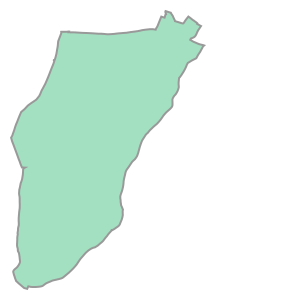

In [7]:
gis_data.geometry[0] #example of a polygon

In [8]:
# We only need GSS_CODE which will rename to code, and geometry column that 
#contains data on ward polygons
gis_data = gis_data.filter(['GSS_CODE','geometry'], axis=1)  #drop all columns but code and geometry
gis_data.rename(columns={'GSS_CODE': 'Code'},inplace=True)

In [9]:
gis_data.head()

,Code,geometry
0,E05000405,"POLYGON ((516401.600 160201.800, 516407.300 16..."
1,E05000414,"POLYGON ((517829.600 165447.100, 517837.100 16..."
2,E05000401,"POLYGON ((518107.500 167303.400, 518114.300 16..."
3,E05000400,"POLYGON ((520480.000 166909.800, 520490.700 16..."
4,E05000402,"POLYGON ((522071.000 168144.900, 522063.900 16..."


Let's find centroids of each polygon which we will use further for API calls:

In [10]:
gis_data['Centroid'] = gis_data['geometry'].centroid  

In [11]:
gis_data.head()

,Code,geometry,Centroid
0,E05000405,"POLYGON ((516401.600 160201.800, 516407.300 16...",POINT (517652.343 162339.161)
1,E05000414,"POLYGON ((517829.600 165447.100, 517837.100 16...",POINT (519124.935 165300.017)
2,E05000401,"POLYGON ((518107.500 167303.400, 518114.300 16...",POINT (519108.407 167344.325)
3,E05000400,"POLYGON ((520480.000 166909.800, 520490.700 16...",POINT (520118.140 166393.329)
4,E05000402,"POLYGON ((522071.000 168144.900, 522063.900 16...",POINT (521204.946 168516.788)


In [12]:
#Right now centroid coordinates are easting and northing in meters 
#which we will convert to longitudes and latitudes

inProj = Proj(gis_data.crs) #current system of coordinates
outProj = Proj(init='epsg:4326') #target system of coordinates

x2,y2 = transform(inProj,outProj,gis_data.Centroid.x,gis_data.Centroid.y)
gis_data['Lon'] = x2
gis_data['Lat'] = y2
gis_data.drop(['geometry','Centroid'],axis=1, inplace=True)

/Users/ksenia/anaconda3/envs/IBMProject_stocks/lib/python3.9/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/Users/ksenia/anaconda3/envs/IBMProject_stocks/lib/python3.9/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))
<ipython-input-12-9ace3bd5c3e5>:7: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-

In [13]:
gis_data.head()

,Code,Lon,Lat
0,E05000405,-0.312030,51.347964
1,E05000414,-0.289904,51.374269
2,E05000401,-0.289457,51.392646
3,E05000400,-0.275273,51.383886
4,E05000402,-0.258938,51.402740


We have successfully converted easting and northing to degrees.

#### Income data

In [14]:
income = pd.read_csv('modelled-household-income-estimates-wards.csv')

In [15]:
income=income[['Code', 'Median 2012/13']]  #we will select latest available data
income = income.replace(',','', regex=True) #cleaning data from commas
income = income.replace('�','', regex=True)  #cleaning data from that weird quesiton character
income.rename(columns={'Median 2012/13': 'Income'}, inplace=True)
income.Income=income.Income.astype(int)

In [16]:
income.head()

,Code,Income
0,E09000001,63620
1,E05000026,33920
2,E05000027,32470
3,E05000028,33000
4,E05000029,33920


#### Open space and parks data

In [17]:
space = pd.read_excel('access-public-open-space-ward.xls',sheet_name=3)  #reading excel file, third sheet
space=space.iloc[:,[0,6]]

space.rename(columns={'Ward_GSS_CODE': 'Code', '% open space': 'open_space'}, inplace=True)
space.head()

,Code,open_space
0,E05000026,21.908601
1,E05000027,20.621849
2,E05000028,1.885448
3,E05000029,55.974507
4,E05000030,50.434179


## Data wrangling

Let's create master dataframe

In [18]:
data = wards.merge(gis_data, on='Code', how='left')  #merge coordinates
data = data.merge(space, on='Code', how='left')  #merge open space of wards [%]
data = data.merge(income, on='Code', how='left')  #merge income
# we will calculate adjusted population density (take into account non-open area of the ward)
data['adjusted_density'] = data.Population/(data.km2*(1-data.open_space/100))
data.dropna(axis=0, inplace=True)  #drop any rows with NaN values
data.head()


,Code,Borough,Ward_Name,Year,Population,km2,Population_density,Lon,Lat,open_space,Income,adjusted_density
0,E05000026,Barking and Dagenham,Abbey,2021,16938,1.279,13243.158720,0.077935,51.539711,21.908601,33920,16958.536974
1,E05000027,Barking and Dagenham,Alibon,2021,11323,1.361,8319.617928,0.148269,51.545589,20.621849,32470,10480.992402
2,E05000028,Barking and Dagenham,Becontree,2021,14891,1.284,11597.352020,0.118956,51.554534,1.885448,33000,11820.216016
3,E05000029,Barking and Dagenham,Chadwell Heath,2021,11297,3.380,3342.307692,0.139985,51.584751,55.974507,33920,7591.755359
4,E05000030,Barking and Dagenham,Eastbrook,2021,11032,3.454,3193.977997,0.173580,51.553647,50.434179,37400,6443.912206


### Foursquare API calls

API calls are in the other notebook that is accessible [here](https://github.com/ksenia-tabakova/Coursera_Capstone/blob/ccdb623cca97b0f5188105658d43e7bf8f3b8f5b/API_calls.ipynb)

### Read restaurants data

In [19]:
restaurants = pd.read_csv('all_restaurants.csv')
restaurants.head()

,Code,Ward Lat,Ward Lon,Venue,Venue Lat,Venue Lon,Venue Category
0,E05000026,51.539711,0.077935,Cristina's,51.536523,0.076672,Steakhouse
1,E05000026,51.539711,0.077935,Nando's,51.539780,0.082297,Portuguese Restaurant
2,E05000026,51.539711,0.077935,Subway,51.538000,0.081319,Sandwich Place
3,E05000026,51.539711,0.077935,Domino's Pizza,51.539833,0.082223,Pizza Place
4,E05000026,51.539711,0.077935,KFC,51.539117,0.080792,Fast Food Restaurant


In [20]:
print('There are {} uniques categories.'.format(len(restaurants['Venue Category'].unique())))

There are 137 uniques categories.


In [21]:
pd.unique(restaurants['Venue Category'])

array(['Steakhouse', 'Portuguese Restaurant', 'Sandwich Place',
       'Pizza Place', 'Fast Food Restaurant', 'Café', 'Breakfast Spot',
       'Fried Chicken Joint', 'Fish & Chips Shop', 'Indian Restaurant',
       'Bakery', 'English Restaurant', 'Restaurant', 'Diner',
       'Chinese Restaurant', 'Eastern European Restaurant',
       'Turkish Restaurant', 'Comfort Food Restaurant', 'Food',
       'Kebab Restaurant', 'Greek Restaurant', 'American Restaurant',
       'Wings Joint', 'Food Truck', 'Sushi Restaurant',
       'Italian Restaurant', 'Modern European Restaurant',
       'French Restaurant', 'Middle Eastern Restaurant', 'Deli / Bodega',
       'Seafood Restaurant', 'Japanese Restaurant', 'Thai Restaurant',
       'Burger Joint', 'Vietnamese Restaurant', 'Korean Restaurant',
       'Gastropub', 'Argentinian Restaurant', 'Cantonese Restaurant',
       'Bagel Shop', 'Irish Pub', 'Noodle House', 'Burrito Place',
       'Mediterranean Restaurant', 'Asian Restaurant', 'Bistro',
     

Our client operates Italian, American and Mexican cuisine restaurants. 

We will divide all types of restaurants and food place for four categories: American, Mexican, Italian and other. 


In [22]:
american = sorted(['Fried Chicken Joint', 'Diner', 'American Restaurant', 'Wings Joint', 'Bagel Shop', 'Burger Joint',
           'Australian Restaurant', 'Southern / Soul Food Restaurant', 'Cajun / Creole Restaurant', 'New American Restaurant', 'BBQ Joint',])

italian = sorted(['Pizza Place', 'Italian Restaurant', 'Veneto Restaurant'])

mexican = sorted(['Burrito Place', 'Mexican Restaurant', 'Taco Place'])

In [23]:
type_list = [american, italian, mexican]
cuisine_categs = ['american', 'italian', 'mexican']

In [24]:
categ_data = []
for vtype in restaurants['Venue Category']:
    found = 0
    for num, a_list in enumerate(type_list):
        
        if vtype in a_list:
            categ_data.append(cuisine_categs[num])
            found = 1
            continue
    if found == 0:
        categ_data.append('other')
restaurants['Type'] = categ_data

In [25]:
restaurants.head()

,Code,Ward Lat,Ward Lon,Venue,Venue Lat,Venue Lon,Venue Category,Type
0,E05000026,51.539711,0.077935,Cristina's,51.536523,0.076672,Steakhouse,other
1,E05000026,51.539711,0.077935,Nando's,51.539780,0.082297,Portuguese Restaurant,other
2,E05000026,51.539711,0.077935,Subway,51.538000,0.081319,Sandwich Place,other
3,E05000026,51.539711,0.077935,Domino's Pizza,51.539833,0.082223,Pizza Place,italian
4,E05000026,51.539711,0.077935,KFC,51.539117,0.080792,Fast Food Restaurant,other


### One hot encoding

In [26]:
# one hot encoding
onehot = pd.get_dummies(restaurants[['Type']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
onehot['Code'] = restaurants['Code'] 

# move neighborhood column to the first column
fixed_columns = [onehot.columns[-1]] + list(onehot.columns[:-1])
onehot = onehot[fixed_columns]

onehot.head()


,Code,american,italian,mexican,other
0,E05000026,0,0,0,1
1,E05000026,0,0,0,1
2,E05000026,0,0,0,1
3,E05000026,0,1,0,0
4,E05000026,0,0,0,1


In [27]:
data_grouped = onehot.groupby('Code').mean().reset_index()
data_grouped

,Code,american,italian,mexican,other
0,E05000026,0.000000,0.090909,0.000000,0.909091
1,E05000027,0.333333,0.333333,0.000000,0.333333
2,E05000028,0.000000,0.000000,0.000000,1.000000
3,E05000029,0.000000,0.000000,0.000000,1.000000
4,E05000031,0.000000,0.000000,0.000000,1.000000
...,...,...,...,...,...
603,E05000645,0.000000,0.133333,0.033333,0.833333
604,E05000646,0.000000,0.105769,0.038462,0.855769
605,E05000647,0.021898,0.182482,0.029197,0.766423
606,E05000648,0.024691,0.148148,0.012346,0.814815


In [28]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [29]:
num_top_venues = 4

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Code']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

In [30]:
# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Code'] = data_grouped['Code']

for ind in np.arange(data_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(data_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Code,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue
0,E05000026,other,italian,american,mexican
1,E05000027,american,italian,other,mexican
2,E05000028,other,american,italian,mexican
3,E05000029,other,american,italian,mexican
4,E05000031,other,american,italian,mexican


### K-means clustering

Let's merge data dataframe with grouped data dataframe. We will also count total number of restaurants as well as number of restaurants per 1000 people for each ward.

In [31]:
london_merged = data.merge(data_grouped,how='left', on='Code')
number_of_rest = pd.DataFrame([restaurants.Code.value_counts().index.tolist(),restaurants.Code.value_counts().tolist()]).transpose()
number_of_rest = number_of_rest.sort_values(by=[0]).reset_index()
number_of_rest.head()
london_merged['Restaurant_number'] = number_of_rest[1].astype(int)
london_merged
london_merged['rest_per_1000']=pd.DataFrame(london_merged.Restaurant_number/london_merged.Population*1000)
london_merged.dropna(axis=0, inplace=True)

london_merged.columns

Index(['Code', 'Borough', 'Ward_Name', 'Year', 'Population', 'km2',
       'Population_density', 'Lon', 'Lat', 'open_space', 'Income',
       'adjusted_density', 'american', 'italian', 'mexican', 'other',
       'Restaurant_number', 'rest_per_1000'],
      dtype='object')

#### Remove outliers
We want to remove outlier wards from the dataframe. We will use STD*3 method to define which wards should be removed from the further analysis. We use zscore method from scipy.stats.
We selected four columns which we will check for outliers:
1. Population 
2. Population density
3. Number of restaurants per 1000 people
4. Income

In [32]:
outlier_cols=london_merged[['Population','Population_density','rest_per_1000', 'Income']]
constrains = outlier_cols.select_dtypes(include=[np.number]).apply(lambda x: np.abs(stats.zscore(x))<3).all(axis=1)
outliers=london_merged.copy()
london_merged.drop(london_merged.index[~constrains], inplace=True)
outliers.drop(outliers.index[constrains], inplace=True)

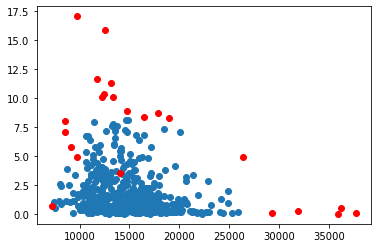

In [33]:
# Let's check quickly which data points we have excluded
plt.scatter(x='Population', y='rest_per_1000', data=london_merged)
plt.scatter(x='Population', y='rest_per_1000', data=outliers, c='red')

#### Clustering

We hypothesise that we can perform clustering based on demography (population, population density, adjusted population density), number of restaurants and income. 


Exploring scatterplots of selected parameters:

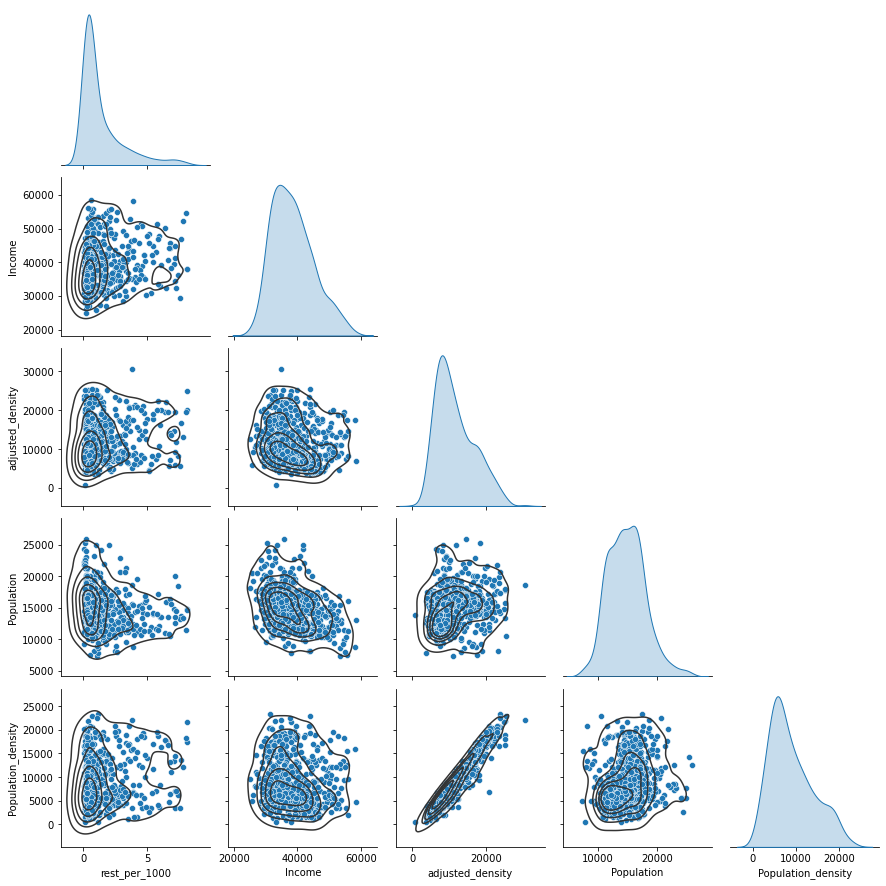

In [34]:
plot_df = london_merged[['rest_per_1000', 'Income', 'adjusted_density','Population', 'Population_density']]
g=sns.pairplot(plot_df, corner=True, diag_kind = 'kde')
g.map_lower(sns.kdeplot, levels=6, color=".2")
plt.savefig('feature_selection.png', dpi=150)

There are several important observations we need to make about our data before we proceed.
1. We can see that there doesn't exist obvious correlation between selected parameters. For instance, higher population_density does not necessarily go hand in hand with more restaurants per 1000 citizens. Neither income directly impacts number of restaurants per 1000 citizens. In some cases lower income wards have high number of restaurants/1000 people. Income and population display some connection - the higher median income of the ward, the fewer people inhabit it: we attribute it to be suburban districts where housing is more scarce because people own private houses, whilst private house is more expensive property to own or rent. 
2. Adding adjusted population density did not yield desired result - there is still not clear connection with restaurant number per 1000 people (neither with absolute number of restaurants, not shown here). 
3. From the business point of view, income and restaurants/1000 people are important parameters to make decision over. Adding any extra parameters which do not affect those would be unnecessary and wasteful in terms of computational and analysis time.

To conclude, we will select two parameters for kmeans clustering - <b>Income</b> and <b># of restaurants per 1000 people</b> - to aid decision making. Some wards clearly have bustling restaurant scene and we hope we can discriminate between bustling/non-bustling and then look further on the distribution of types of restaurants.


##### Prepare data for clustering

In [35]:
featureset = london_merged[['rest_per_1000', 'Income']]
x = featureset.values #returns a numpy array
min_max_scaler = MinMaxScaler()
feature_mtx = min_max_scaler.fit_transform(x)

##### Select best k-value

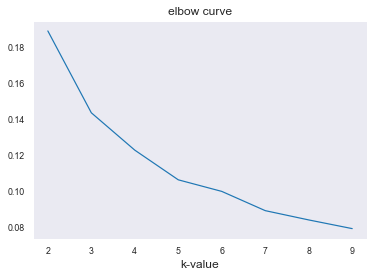

In [44]:
res = list()
n_cluster = range(2,10)
for n in n_cluster:
    kmeans = KMeans(n_clusters=n, random_state=1)
    kmeans.fit(feature_mtx)
    res.append(np.average(np.min(cdist(feature_mtx, kmeans.cluster_centers_, 'euclidean'), axis=1)))
plt.plot(n_cluster, res)
plt.title('elbow curve')
plt.xlabel('k-value')
plt.savefig('elbow.png', dpi=150)
plt.show()


Unsurprisingly, the curve is smooth with no distinct elbow. The closes to elbow point is to 3. We will select it.

In [41]:
kclusters = 3

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=1).fit(feature_mtx)
# check cluster labels generated for each row in the dataframe 
london_merged['kmeans_demog'] = kmeans.labels_

In [42]:
plot_df= featureset.copy()
#plot_df['Population_density'] = london_merged['Population_density']
plot_df['kmeans_demog'] = london_merged['kmeans_demog']

Let's explore clusters

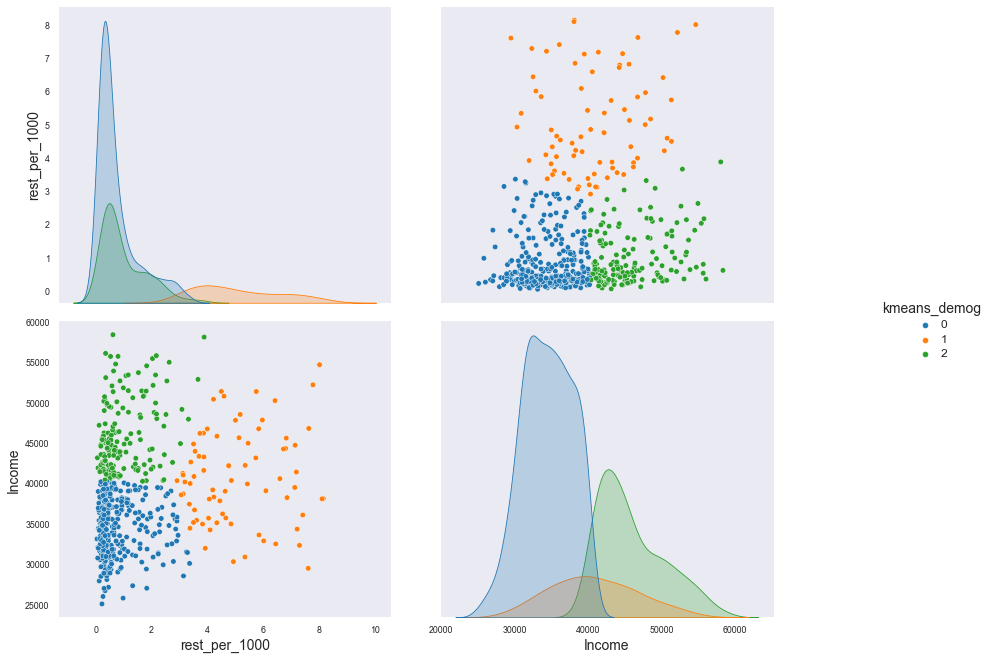

In [45]:
sns.set_style('dark')
sns.set_context("paper", rc={"font.size":12,"axes.titlesize":12,"axes.labelsize":14})  
gfg=sns.pairplot(plot_df, hue="kmeans_demog", palette='tab10',plot_kws={"s": 30})
plt.setp(gfg._legend.get_title(), fontsize=14)
plt.setp(gfg._legend.get_texts(), fontsize=12)
gfg.fig.set_size_inches(15,10)
plt.savefig('clusters.png', dpi=150)

In [46]:
plot_df.kmeans_demog.value_counts()/(plot_df.kmeans_demog.value_counts().sum())*100

0    57.996485
2    28.646749
1    13.356766
Name: kmeans_demog, dtype: float64

Our clusters can be described as followed:

- Cluster 0: generally lower income, less lively restaurant life. 58% of wards.
- Cluster 1: varying income, lively restaurant life, 13% of wards.
- Cluster 2: generally higher income, less lively restaurant life. 29% of wards

As expected, clusters overlap, but there are also differences between them and it helps us to make decisions. This will be an asset and will simplify recommendation making.


#### Candidate wards - reasoning
Let us discuss type of wards that would be the best candidate to open restaurants.

- Wards with higher income and less lively restaurant life. People have money to spend but restaurant life in the neighborhood is not saturated. Cluster 2.
- Wards with lively restaurant life - people are going out to eat regardless of the income. Cluster 1.
- Wards with not lively restaurant life and smaller income - there is a potential for success if type of restaurant is considered carefully. Cluster 0.

#### Distribution of Mexican, American and Italian restaurants between clusters

In [47]:
means = pd.DataFrame()
for clu in range(3):
    cluster = london_merged.loc[london_merged['kmeans_demog'] == clu, ['italian', 'american', 'mexican']].describe()
    #print(means.append(cluster.loc['mean']))
    means = means.append(cluster.loc['mean'])
means.reset_index(drop=True, inplace=True)  #mean fraction of restaurants of selected types within wards of given cluster

In [48]:
size=25
params = {'legend.fontsize': 'large',
          'figure.figsize': (20,8),
          'axes.labelsize': size,
          'axes.titlesize': size,
          'xtick.labelsize': size*0.75,
          'ytick.labelsize': size*0.75,
          'axes.titlepad': 25}
plt.rcParams.update(params)


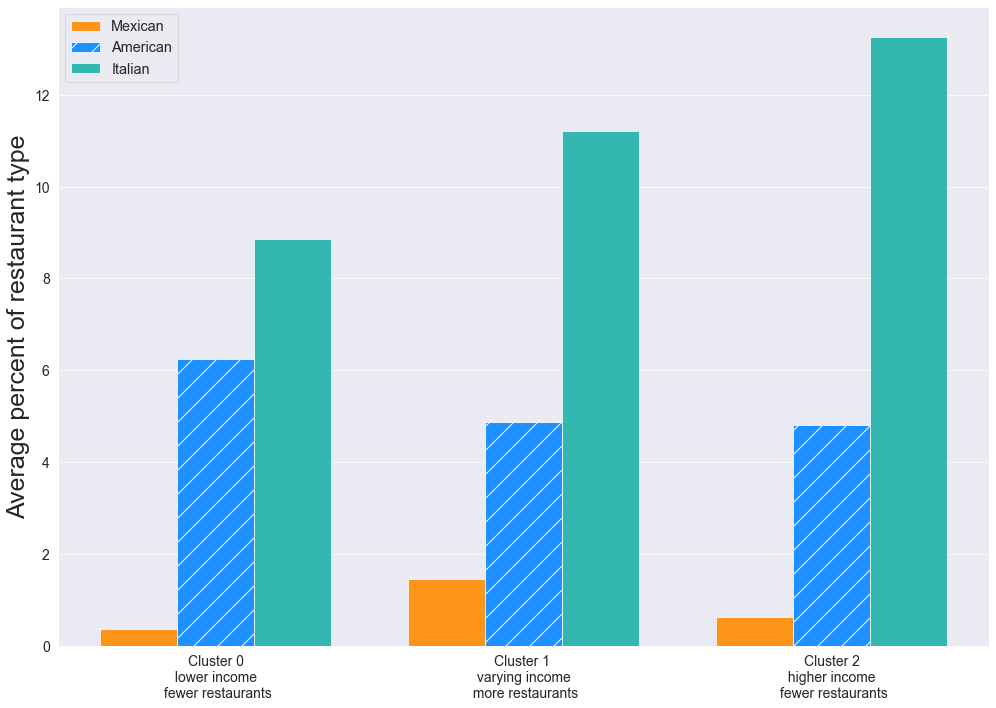

In [51]:

labels = ['Cluster 0\n lower income \n fewer restaurants', 'Cluster 1 \n varying income \n more restaurants', \
          'Cluster 2\n higher income \n fewer restaurants']
it_means = means.italian
me_means = means.mexican
am_means = means.american


x = np.arange(len(labels))  # the label locations
width = 0.25  # the width of the bars

fig, ax = plt.subplots(figsize=(14,10))
rects1 = ax.bar(x - width, me_means*100, width, label='Mexican', color=mcolors.CSS4_COLORS['darkorange'], alpha=0.9)
rects2 = ax.bar(x, am_means*100, width, label='American', color=mcolors.CSS4_COLORS['dodgerblue'], hatch='/')
rects3 = ax.bar(x + width, it_means*100, width, label='Italian', color=mcolors.CSS4_COLORS['lightseagreen'], alpha=0.9)

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Average percent of restaurant type')
#ax.set_title('Scores by group and gender')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()
plt.tick_params(labelsize=14)
plt.grid(axis='y')

fig.tight_layout()
plt.savefig('distribution.png', dpi=150)
plt.show()

### Recommendations

We can start making decisions and recommendations.

- Mexican restaurants are in minority overall, regardless of the cluster. It means that our client can seriously consider opening mexican restaurants, particularly in wards of Clusters 0 and 2. 
- Italian restaurants are most prevalent accross wards, taking up from 9 to 14.5 % of total number, depending on the ward. Competition is high in this segment. We will not recommend opening more restaurants in either of clusters.
- American cuisine represents 4-6% of all food venues across wards. There is a possibility to add more american restaurants in Clusters 1 and 2.

Let's summarize recommendations by clusters.
- Cluster 0 (lower income, fewer restaurants per 1000) - Mexican; lower price tag.
- Cluster 1 (lively restaurant life regardless of income) - Mexican, American; both lower and higher price tag possible.
- Cluster 2 (high income, fewer restaurants per 1000) - Mexican, American, higher price tag possible.

### Mapping recommendations

In [ ]:
# Add columns to df with recommendations
london_merged['recommendation']=np.nan

london_merged['recommendation'].loc[(london_merged['kmeans_demog'] == 0)] = 'Mexican; lower price tag'
london_merged['recommendation'].loc[(london_merged['kmeans_demog'] == 1)] = 'Mexican, American; lower-higher price tag'
london_merged['recommendation'].loc[(london_merged['kmeans_demog'] == 2)] = 'Mexican, American; higher price tag'

In [53]:
map_df = london_merged[['Ward_Name', 'Lat', 'Lon', 'kmeans_demog', 'recommendation']]


In [54]:
address = 'London, UK'
geolocator = Nominatim(user_agent="london_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of London are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of London are 51.5073219, -0.1276474.


In [60]:
# create map

map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = [mcolors.CSS4_COLORS['cornflowerblue'],mcolors.CSS4_COLORS['darkorange'],mcolors.CSS4_COLORS['mediumseagreen']]


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster, recom in zip(map_df['Lat'], map_df['Lon'], map_df['Ward_Name'], map_df['kmeans_demog'], map_df['recommendation']):
    label = folium.Popup(str(poi) + ': ' + recom, parse_html=True)

    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=colors_array[cluster-1],
        fill=True,
        fill_color=colors_array[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       

map_clusters
map_clusters.save('cluster_map.html')
#plt.savefig('cluster_map.png', dpi=150)    

Cluster map (inserting in case notebook does not display interactive map)
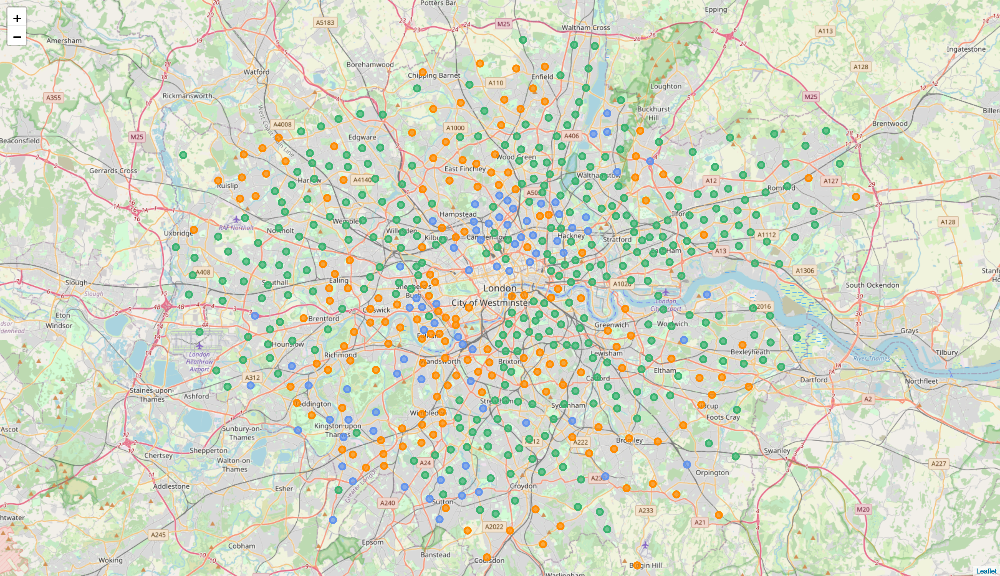

### Narrowing down selection of the wards

#### Population growth as factor

Population growth is an important factor to forecast success of the new venue. We will use predicted population growth for the next 5 years to narrow down the most perspective wards for each cluster.

In [61]:
# Read wards data and calculate population growth
df = pd.read_csv('housing-density-ward.csv')
df.drop(['Hectares', 'Population_per_hectare'], axis=1, inplace = True)
df = df[(df.Year == 2026) | (df.Year == 2021)]
df.rename(columns={'Square_Kilometres': 'km2', 'Population_per_square_kilometre': 'Population_density'}, inplace=True)
y2021=df[df.Year==2021].reset_index(drop=True)
y2026=df[df.Year==2026].reset_index(drop=True)
y2021.reset_index(drop=True, inplace=True)
y2021['Growth']=(y2026['Population']-y2021['Population'])/y2021['Population']*100
y2021 = y2021.filter(['Code','Growth'], axis=1)

y2021.head()

,Code,Growth
0,E05000026,16.979573
1,E05000027,2.137243
2,E05000028,-2.961520
3,E05000029,0.141631
4,E05000030,-0.290065


In [62]:
london_merged = london_merged.merge(y2021, how='left', on='Code')

london_merged.head()

,Code,Borough,Ward_Name,Year,Population,km2,Population_density,Lon,Lat,open_space,...,adjusted_density,american,italian,mexican,other,Restaurant_number,rest_per_1000,kmeans_demog,recommendation,Growth
0,E05000026,Barking and Dagenham,Abbey,2021,16938,1.279,13243.158720,0.077935,51.539711,21.908601,...,16958.536974,0.000000,0.090909,0.0,0.909091,11.0,0.649427,0,Mexican; lower price tag,16.979573
1,E05000027,Barking and Dagenham,Alibon,2021,11323,1.361,8319.617928,0.148269,51.545589,20.621849,...,10480.992402,0.333333,0.333333,0.0,0.333333,3.0,0.264947,0,Mexican; lower price tag,2.137243
2,E05000028,Barking and Dagenham,Becontree,2021,14891,1.284,11597.352020,0.118956,51.554534,1.885448,...,11820.216016,0.000000,0.000000,0.0,1.000000,4.0,0.268619,0,Mexican; lower price tag,-2.961520
3,E05000029,Barking and Dagenham,Chadwell Heath,2021,11297,3.380,3342.307692,0.139985,51.584751,55.974507,...,7591.755359,0.000000,0.000000,0.0,1.000000,4.0,0.354076,0,Mexican; lower price tag,0.141631
4,E05000031,Barking and Dagenham,Eastbury,2021,12299,1.445,8511.418685,0.105683,51.535896,17.108935,...,10268.198047,0.000000,0.000000,0.0,1.000000,9.0,0.731767,0,Mexican; lower price tag,-0.243922


Now we have information in the data frame about predicted growth of population. Let's select wards with top 10 predicted growth for each cluster.

In [63]:
best = dict()
for clu in range(3):
    cluster = london_merged[london_merged.kmeans_demog==clu].sort_values(by='Growth', ascending=False)
    best[clu]=cluster.head(10).reset_index(drop=True)

### Mapping best 10 wards per cluster

In [77]:
# create map

map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = [mcolors.CSS4_COLORS['cornflowerblue'],mcolors.CSS4_COLORS['darkorange'],mcolors.CSS4_COLORS['mediumseagreen']]
#icons = ['flag-usa', 'pepper_hot']
colors=['blue','orange', 'green']

# add markers to the map
for clu in range(3):
    cluster_df = best[clu]
    for lat, lon, poi, cluster, recom in zip(cluster_df['Lat'], cluster_df['Lon'], cluster_df['Ward_Name'], cluster_df['kmeans_demog'], cluster_df['recommendation']):
        label = folium.Popup(str(poi) + ': ' + recom, parse_html=True)
        folium.Marker(
            location=[lat, lon],
            popup=label,
            icon=folium.Icon(icon='circle', 
                             prefix='fa',
                             color=colors[clu])
            ).add_to(map_clusters)

#map_clusters

colors_legend = [mcolors.TABLEAU_COLORS['tab:blue'],mcolors.TABLEAU_COLORS['tab:orange'],mcolors.TABLEAU_COLORS['tab:green']]

### Create legend
from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
  <script>
  $( function() {
    $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
});

  </script>
</head>
<body>


<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:16px; right: 20px; top: 20px;'>
     
<div class='legend-title'>Recommended restaurant</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:#1f77b4;opacity:0.7;'></span>Mexican; lower price tag</li>
    <li><span style='background:#ff7f0e;opacity:0.7;'></span>Mexican, American; lower-higher price tag</li>
    <li><span style='background:#2ca02c;opacity:0.7;'></span>Mexican, American; higher price tag</li>

  </ul>
</div>
</div>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 90%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

map_clusters.get_root().add_child(macro)


map_clusters.save('best_cluster.html')
map_clusters

Copying map for best 10 wards in each ward (in case interactive map does not display)
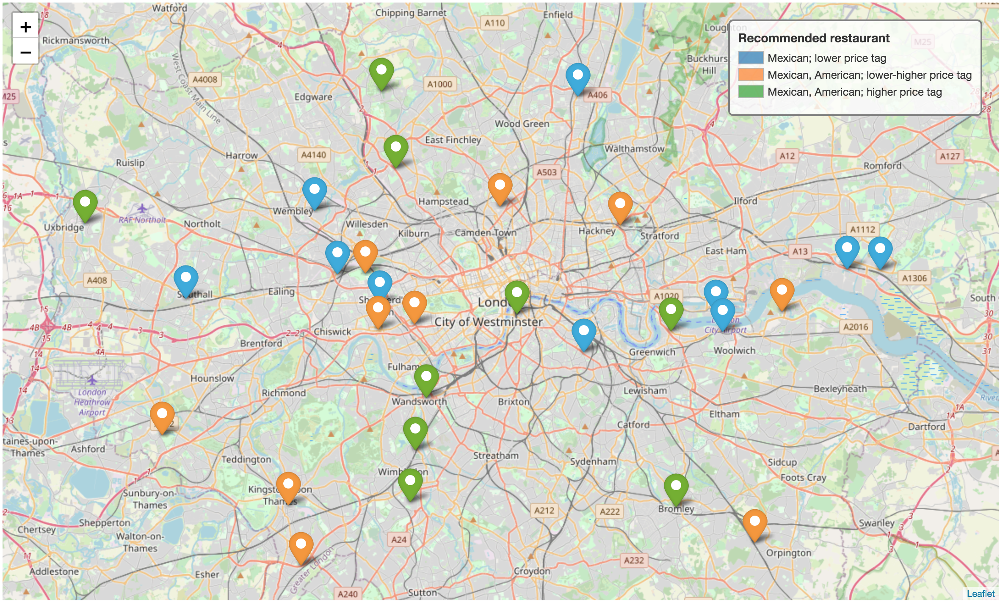

In [ ]:
### Print tables with best wards

In [67]:
best[0][['Ward_Name','Borough', 'recommendation', 'Growth']].head(10)

,Ward_Name,Borough,recommendation,Growth
0,Tokyngton,Brent,Mexican; lower price tag,41.209948
1,Southall Broadway,Ealing,Mexican; lower price tag,36.752350
2,Upper Edmonton,Enfield,Mexican; lower price tag,34.864208
3,East Acton,Ealing,Mexican; lower price tag,33.780928
4,River,Barking and Dagenham,Mexican; lower price tag,31.392330
5,Royal Docks,Newham,Mexican; lower price tag,30.947766
6,Woolwich Riverside,Greenwich,Mexican; lower price tag,29.156801
7,Shepherd's Bush Green,Hammersmith and Fulham,Mexican; lower price tag,27.902053
8,Livesey,Southwark,Mexican; lower price tag,27.450753
9,South Hornchurch,Havering,Mexican; lower price tag,27.143833


In [69]:
best[1][['Ward_Name','Borough', 'recommendation', 'Growth']].head(10)

,Ward_Name,Borough,recommendation,Growth
0,College Park and Old Oak,Hammersmith and Fulham,"Mexican, American; lower-higher price tag",74.080560
1,Hammersmith Broadway,Hammersmith and Fulham,"Mexican, American; lower-higher price tag",22.425598
2,Grove,Kingston upon Thames,"Mexican, American; lower-higher price tag",14.137752
3,Wick,Hackney,"Mexican, American; lower-higher price tag",11.865915
4,Thamesmead Moorings,Greenwich,"Mexican, American; lower-higher price tag",11.692020
5,Tolworth and Hook Rise,Kingston upon Thames,"Mexican, American; lower-higher price tag",11.020060
6,Abingdon,Kensington and Chelsea,"Mexican, American; lower-higher price tag",10.816220
7,Petts Wood and Knoll,Bromley,"Mexican, American; lower-higher price tag",8.571807
8,Hanworth Park,Hounslow,"Mexican, American; lower-higher price tag",8.273296
9,St George's,Islington,"Mexican, American; lower-higher price tag",8.026685


In [71]:
best[2][['Ward_Name','Borough', 'recommendation', 'Growth']].head(10)

,Ward_Name,Borough,recommendation,Growth
0,Peninsula,Greenwich,"Mexican, American; higher price tag",33.959538
1,Golders Green,Barnet,"Mexican, American; higher price tag",26.228589
2,Uxbridge North,Hillingdon,"Mexican, American; higher price tag",17.434613
3,Merton Park,Merton,"Mexican, American; higher price tag",16.453983
4,Bromley Town,Bromley,"Mexican, American; higher price tag",15.143942
5,Mill Hill,Barnet,"Mexican, American; higher price tag",13.643449
6,Fairfield,Wandsworth,"Mexican, American; higher price tag",12.936550
7,Wimbledon Park,Merton,"Mexican, American; higher price tag",10.707833
8,Coulsdon West,Croydon,"Mexican, American; higher price tag",10.362507
9,Bishop's,Lambeth,"Mexican, American; higher price tag",9.698699


## Discussion

K-means clustering on median income and number of restaurants per 1000 people have produced three clusters of wards: (1) relatively lower income, fewer restaurants; (2) varying income, more restaurants; (3) higher income, fewer restaurants. Despite some overlap between cluster characteristic, these clusters have different enough properties to be further utilized in the recommendation-making. 

Looking into distribution of American, Mexican and Italian cuisine revealed that Mexican restaurants are in minority, therefore making it good candidate for a new restaurant. On the other hand, the fact that Mexican cuisine is not as common as the rest might point that people prefer other types of restaurants, other cuisines. But from variety point of view Mexican restaurants can bring the most of it to a ward.

American cuisine restaurants (including diners, burger joints) take from 4 to 6% of the restaurants in every cluster. Potentially, American restaurant can gain success in either of the clusters, but narrowing down focus to clusters 1 and 2 is the most sensible.

Italian restaurants are the most popular type of restaurants from considered: from 9% in Cluster 0 to 13% in Cluster 2. The competition in this sector is highest. I do not recommend opening Italian restaurants to the client.

Median income of cluster will be the basis of recommendation for the price range:
- Cluster 0: lower priced menu.
- Cluster 1: both lower and higher priced menu is possible.
- Cluster 2: higher price menu.

As it happens often with the real-life data, this project was not as straightforward as expected. I hypothesized that population density has an effect on the total number of restaurants or number of restaurants per 1000 people. Even though such dependency would be logical (the higher the density of populations/customers, the more small businesses including restaurants it can support), there seems to exist other factor(s) that impacts number of restaurants. It might be population distribution (i.e. age distribution), or number of non-residential buildings that can host restaurant. Either way, our data could not help identifying this parameter.

On the positive side, clustering based on the median income and number of restaurants per 1000 people yielded satisfactory results. It was possible to developed data-based recommendations about location, type and menu price range for a restaurant.


## Conclusion

In this study I analyzed wards (proxy for neighborhoods) in the Greater London area to determine which areas are the best to open either American, Mexican or Italian cuisine restaurant. Additionally, I determined which price range for menu would be the most suitable.  I have performed k-means clustering to classify wards. I have developed recommendation on what type of restaurant (cuisine and price range) can be open at which wards. Using predicted population growth during next 5 years I selected top 10 best candidates for each cluster (30 best wards in total). 